In [4]:
push!(LOAD_PATH, pwd());
using SelfDrivingFilters
using Distributions
using VariableTransforms
using Gadfly
using DataFrames
using Optim
using Statistics: mean, var
using SpecialFunctions
import LineSearches
include("helper_functions.jl")

plot_models (generic function with 2 methods)

# Criterion setup 

In [5]:
function ll_t(parameters, data_t)
    σ²=from_R_to_pos(parameters[1]);
    μ=parameters[2];
    ν=from_R_to_pos(parameters[3])+2;

    yt=data_t[1]
    ε²=(yt-μ)^2

    if ν>500
        ll=-0.5*log(2π)-0.5*log(σ²)-0.5*(yt-μ)^2/σ²
    else
        ll=loggamma((ν+1)/2) - loggamma(ν/2) - 0.5*log(ν) -0.5*log(π) - 0.5*log(σ²) - (ν+1)/2*log(1 + ε²/σ²/ν)
    end
    -ll
end

ll_t (generic function with 1 method)

In [6]:
struct tGAS_results
    paths::Array{Number,2}
end
function tgas_criterion(parameters::AbstractArray{S,1}, data) where {S<:Number}
    μ,ν,ω,A,B=parameters
    ν=from_R_to_pos(ν)+2
    A=from_R_to_pos(A)
    B=from_R_to_11(B)
    ll=zero(S)
    fts=Array{S,2}(undef,3,length(data)+1)
    fts[1,1]=ω
    fts[2,:].=μ
    fts[3,:].=ν

    try
        for i=1:length(data)
            yt=data[i]
            ε²=(yt-μ)^2
            if ν>500
                ll+=-0.5*log(2π)-0.5*log(fts[1,i])-0.5*(yt-μ)^2/fts[1,i]
            else
                ll+=loggamma((ν+1)/2) - loggamma(ν/2) - 0.5*log(ν) -0.5*log(π) - 0.5*log(fts[1,i]) - (ν+1)/2*log(1 + ε²/fts[1,i]/ν)
            end
            st=(1+3*1/ν)*( (1+1/ν)/( (1-2*1/ν)*(1+1/ν*ε²/fts[1,i]/(1-2*1/ν)) )*ε² - fts[1,i] );
            fts[1,i+1:i+1].=ω+B*(fts[1,i]-ω)+A*st
        end
        return ll/length(data), fts
    catch
        return -Inf, []
    end
end

tgas_criterion (generic function with 1 method)

# Simulated data 

## Time-varying scale

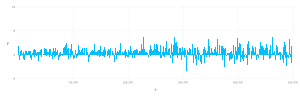

In [7]:
T=5000
μ=fill(0.5,T)
σ2=structural_breaks(T,[0.5,1.0],[1,1])
ν=fill(7.5,T)
d=[rand(MvTDist(i,[j],fill(k,1,1)))[1] for (i,j,k) in zip(ν,μ,σ2)];
true_paths=[σ2 μ ν]'
draw(SVG(30cm,10cm),plot(x=1:T,y=d,Geom.bar,Coord.Cartesian(xmin=1,xmax=T)))

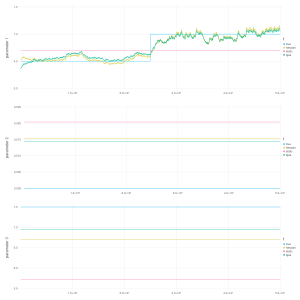

In [9]:
#Self-driving
tv_ix=[true;false;false]
model=define_model(
    tv_ix,
    ll_t;
    parameter_transforms=(
        (1, from_R_to_pos),
        (3, x->from_R_to_pos(x)+2.),
    ),
    filter_type=:sparse,
    scaling_options=(:hessian, 0.9999),
    init_options=(:reverse_run,1.0)
#     init_options=:static,
)
add_data!(model, d)
ω = [from_pos_to_R(std(d));mean(d);from_pos_to_R(20-2)]
fit!(model, ω; As=[0.01;0.1], Bs=[0.99;0.999]);

#tGAS(1,1)
tgas_initial_parameters=[mean(d);from_pos_to_R(20-2);var(d);from_pos_to_R(0.01);from_11_to_R(0.95)]
criterion=x-> -tgas_criterion(x, d)[1]
r=Optim.optimize(criterion, tgas_initial_parameters, Optim.NelderMead())
r=Optim.optimize(criterion, r.minimizer, Optim.BFGS())
fts=tgas_criterion(r.minimizer, d)[2]

plot_models(true_paths, Dict(
    :static=>model.results.static,
    :hessian=>model.results.best,
    :tgas=>tGAS_results(fts)
))

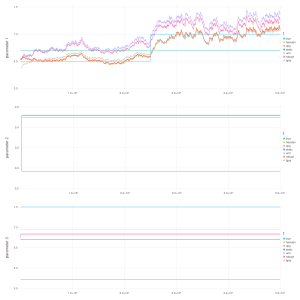

In [10]:
models=Dict{Any,Any}()

#tGAS(1,1)
tgas_initial_parameters=[mean(d);from_pos_to_R(20-2);var(d);from_pos_to_R(0.01);from_11_to_R(0.95)]
criterion=x-> -tgas_criterion(x, d)[1]
r=Optim.optimize(criterion, tgas_initial_parameters, Optim.NelderMead())
r=Optim.optimize(criterion, r.minimizer, Optim.BFGS())
fts=tgas_criterion(r.minimizer, d)[2]
models[:tgas]=tGAS_results(fts)

#Self-driving
for scaling_options in (
        (:hessian, 0.9999),
        (:robust, 0.9999),
        (:opg, 0.9999),
        (:unit,),
    )
    tv_ix=[true;false;false]
    model=define_model(
        tv_ix,
        ll_t;
        parameter_transforms=(
            (1, from_R_to_pos),
            (3, x->from_R_to_pos(x)+2.),
        ),
        filter_type=:sparse,
        scaling_options=scaling_options,
        init_options=(:reverse_run,1.0)
#         init_options=:static
    )
    add_data!(model, d)
    ω = [from_pos_to_R(std(d));mean(d);from_pos_to_R(20-2)]
    fit!(model, ω; As=[0.01;0.1], Bs=[0.99;0.999]);
    models[:static]=model.results.static
    models[scaling_options[1]]=model.results.best
end
plot_models(true_paths, models)

## Time-varying scale and degrees of freedom

In [11]:
T=20000
μ=fill(0.5,T)
σ2=structural_breaks(T,[0.5,1.0],[2,1])
ν=sinusoid(T,5,1).+10
d=[rand(MvTDist(i,[j],fill(k,1,1)))[1] for (i,j,k) in zip(ν,μ,σ2)];
true_paths=[σ2 μ ν]'
draw(SVG(30cm,10cm),plot(x=1:T,y=d,Geom.bar,Coord.Cartesian(xmin=1,xmax=T)))

In [12]:
models=Dict{Any,Any}()

#tGAS(1,1)
tgas_initial_parameters=[mean(d);from_pos_to_R(20-2);var(d);from_pos_to_R(0.01);from_11_to_R(0.95)]
criterion=x-> -tgas_criterion(x, d)[1]
r=Optim.optimize(criterion, tgas_initial_parameters, Optim.NelderMead())
r=Optim.optimize(criterion, r.minimizer, Optim.BFGS())
fts=tgas_criterion(r.minimizer, d)[2]
models[:tgas]=tGAS_results(fts)

#Self-driving
for scaling_options in (
        (:hessian, 0.9999),
        (:robust, 0.9999),
        (:opg, 0.9999),
        (:unit,),
    )
    tv_ix=[true;false;true]
    model=define_model(
        tv_ix,
        ll_t;
        parameter_transforms=(
            (1, from_R_to_pos),
            (3, x->from_R_to_pos(x)+2.),
        ),
        filter_type=:sparse,
        scaling_options=scaling_options,
        init_options=(:reverse_run,1.0)
#         init_options=:static
    )
    add_data!(model, d)
    ω = [from_pos_to_R(std(d));mean(d);from_pos_to_R(20-2)]
    fit!(model, ω; As=[0.01;0.1], Bs=[0.99;0.999]);
    models[:static]=model.results.static
    models[scaling_options[1]]=model.results.best
end
plot_models(true_paths, models)

# S&P500 

In [13]:
using CSV
df=open("market_data.csv","r") do f
    CSV.read(f, DataFrame)
end
d=df[:,:SP500]
first(df,5)

,Date,DAX,SP500
,Date…,Float64,Float64
1,1990-01-03,3.00128,-0.258891
2,1990-01-04,-1.82327,-0.865031
3,1990-01-05,-0.868743,-0.980414
4,1990-01-08,1.2683,0.450432
5,1990-01-09,1.22455,-1.18567


## Time-varying scale 

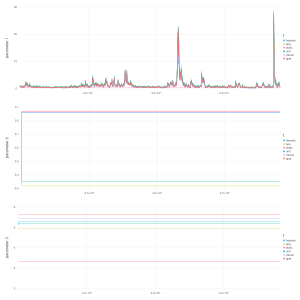

In [14]:
models=Dict{Any,Any}()

#tGAS(1,1)
tgas_initial_parameters=[mean(d);from_pos_to_R(20-2);var(d);from_pos_to_R(0.01);from_11_to_R(0.95)]
criterion=x-> -tgas_criterion(x, d)[1]
r=Optim.optimize(criterion, tgas_initial_parameters, Optim.NelderMead())
r=Optim.optimize(criterion, r.minimizer, Optim.BFGS())
fts=tgas_criterion(r.minimizer, d)[2]
models[:tgas]=tGAS_results(fts)

#Self-driving
for scaling_options in (
        (:hessian, 0.9999),
        (:robust, 0.9999),
        (:opg, 0.9999),
        (:unit,),
    )
    tv_ix=[true;false;false]
    model=define_model(
        tv_ix,
        ll_t;
        parameter_transforms=(
            (1, from_R_to_pos),
            (3, x->from_R_to_pos(x)+2.),
        ),
        filter_type=:sparse,
        scaling_options=scaling_options,
        init_options=(:reverse_run,1.0)
#         init_options=:static
    )
    add_data!(model, d)
    ω = [from_pos_to_R(std(d));mean(d);from_pos_to_R(20-2)]
    fit!(model, ω; As=[0.01;0.1], Bs=[0.99;0.999]);
    models[:static]=model.results.static
    models[scaling_options[1]]=model.results.best
end
plot_models(models)

## Time-varying scale and degrees of freedom

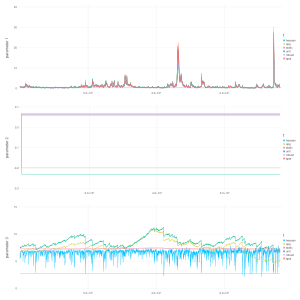

In [15]:
models=Dict{Any,Any}()

#tGAS(1,1)
tgas_initial_parameters=[mean(d);from_pos_to_R(20-2);var(d);from_pos_to_R(0.01);from_11_to_R(0.95)]
criterion=x-> -tgas_criterion(x, d)[1]
r=Optim.optimize(criterion, tgas_initial_parameters, Optim.NelderMead())
r=Optim.optimize(criterion, r.minimizer, Optim.BFGS())
fts=tgas_criterion(r.minimizer, d)[2]
models[:tgas]=tGAS_results(fts)

#Self-driving
for scaling_options in (
        (:hessian, 0.9999),
        (:robust, 0.9999),
        (:opg, 0.9999),
        (:unit,),
    )
    tv_ix=[true;false;true]
    model=define_model(
        tv_ix,
        ll_t;
        parameter_transforms=(
            (1, from_R_to_pos),
            (3, x->from_R_to_pos(x)+2.),
        ),
        filter_type=:sparse,
        scaling_options=scaling_options,
        init_options=(:reverse_run,1.0)
#         init_options=:static
    )
    add_data!(model, d)
    ω = [from_pos_to_R(std(d));mean(d);from_pos_to_R(20-2)]
    fit!(model, ω; As=[0.01;0.1], Bs=[0.99;0.999]);
    models[:static]=model.results.static
    models[scaling_options[1]]=model.results.best
end
plot_models(models)